# Analyse en Composantes Multiples sur la Consommation du Thé

## Importation des packages 

In [1]:
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import fanalysis.mca as MCA
import numpy as np

## Importation et nettoyage des données

In [2]:
df=pd.read_csv("the.csv",sep=";", encoding='latin-1')
df.head()

,ptt dèj,goûter,soirée,après déjeuner,après dîner,tt moment,maison,travail,salon de t,amis,...,bon pr la santé,diurétique,convivialité,absorption fer,féminin,raffiné,amaigrissant,excitant,relaxant,ss effet santé
0,ptt dèj,Pas.goûter,Pas.soirée,Pas.après dèj,Pas.après dîner,Pas.tt moment,maison,Pas.travail,Pas.salon de t,Pas.amis,...,bon pr la santé,Pas.diurétique,Pas.convivialité,Pas.absorption fer,Pas.féminin,Pas.raffiné,Pas.amaigrissant,Pas.excitant,Pas.relaxant,Pas.ss effet santé
1,ptt dèj,Pas.goûter,Pas.soirée,Pas.après dèj,Pas.après dîner,Pas.tt moment,maison,Pas.travail,Pas.salon de t,Pas.amis,...,bon pr la santé,diurétique,Pas.convivialité,Pas.absorption fer,Pas.féminin,Pas.raffiné,Pas.amaigrissant,excitant,Pas.relaxant,Pas.ss effet santé
2,Pas.ptt dèj,goûter,soirée,Pas.après dèj,après dîner,Pas.tt moment,maison,travail,Pas.salon de t,amis,...,bon pr la santé,diurétique,convivialité,Pas.absorption fer,Pas.féminin,Pas.raffiné,Pas.amaigrissant,Pas.excitant,relaxant,Pas.ss effet santé
3,Pas.ptt dèj,Pas.goûter,Pas.soirée,Pas.après dèj,après dîner,Pas.tt moment,maison,Pas.travail,Pas.salon de t,Pas.amis,...,bon pr la santé,Pas.diurétique,Pas.convivialité,Pas.absorption fer,Pas.féminin,raffiné,Pas.amaigrissant,Pas.excitant,relaxant,Pas.ss effet santé
4,ptt dèj,Pas.goûter,soirée,Pas.après dèj,Pas.après dîner,tt moment,maison,Pas.travail,Pas.salon de t,Pas.amis,...,Pas.bon pr la santé,diurétique,convivialité,Pas.absorption fer,Pas.féminin,Pas.raffiné,Pas.amaigrissant,Pas.excitant,relaxant,Pas.ss effet santé


In [3]:
# Dimension du dataframe
df.shape
df.columns

Index(['ptt dèj', 'goûter', 'soirée', 'après déjeuner', 'après dîner',
       'tt moment', 'maison', 'travail', 'salon de t', 'amis', 'resto', 'bar',
       'variété', 'comment', 'sucre', 'forme', 'lieuachat', 'type', 'sexe',
       'CSP', 'Sport', 'âge', 'âge_Q', 'fréquence', 'évasion-exotisme',
       'spiritualité', 'bon pr la santé', 'diurétique', 'convivialité',
       'absorption fer', 'féminin', 'raffiné', 'amaigrissant', 'excitant',
       'relaxant', 'ss effet santé'],
      dtype='object')

In [4]:
# Type de variables

In [5]:
df.dtypes

ptt dèj             object
goûter              object
soirée              object
après déjeuner      object
après dîner         object
tt moment           object
maison              object
travail             object
salon de t          object
amis                object
resto               object
bar                 object
variété             object
comment             object
sucre               object
forme               object
lieuachat           object
type                object
sexe                object
CSP                 object
Sport               object
âge                  int64
âge_Q               object
fréquence           object
évasion-exotisme    object
spiritualité        object
bon pr la santé     object
diurétique          object
convivialité        object
absorption fer      object
féminin             object
raffiné             object
amaigrissant        object
excitant            object
relaxant            object
ss effet santé      object
dtype: object

In [6]:
# Vérification des valeurs nulles
df.isnull().sum()

ptt dèj             0
goûter              0
soirée              0
après déjeuner      0
après dîner         0
tt moment           0
maison              0
travail             0
salon de t          0
amis                0
resto               0
bar                 0
variété             0
comment             0
sucre               0
forme               0
lieuachat           0
type                0
sexe                0
CSP                 0
Sport               0
âge                 0
âge_Q               0
fréquence           0
évasion-exotisme    0
spiritualité        0
bon pr la santé     0
diurétique          0
convivialité        0
absorption fer      0
féminin             0
raffiné             0
amaigrissant        0
excitant            0
relaxant            0
ss effet santé      0
dtype: int64

In [7]:
# Vérification des doublons
df.duplicated().sum()

0

## Analyses Univariées

In [8]:
# Description des variables qualitatives
# Liste des variables qualitatives
categorical_columns = df.select_dtypes(include='object')

for var in categorical_columns:
    print(f'-------------- {var} --------------')
    print(df[var].describe())
    print()

-------------- ptt dèj --------------
count             300
unique              2
top       Pas.ptt dèj
freq              156
Name: ptt dèj, dtype: object

-------------- goûter --------------
count        300
unique         2
top       goûter
freq         169
Name: goûter, dtype: object

-------------- soirée --------------
count            300
unique             2
top       Pas.soirée
freq             197
Name: soirée, dtype: object

-------------- après déjeuner --------------
count               300
unique                2
top       Pas.après dèj
freq                256
Name: après déjeuner, dtype: object

-------------- après dîner --------------
count                 300
unique                  2
top       Pas.après dîner
freq                  279
Name: après dîner, dtype: object

-------------- tt moment --------------
count               300
unique                2
top       Pas.tt moment
freq                197
Name: tt moment, dtype: object

-------------- maison ------------

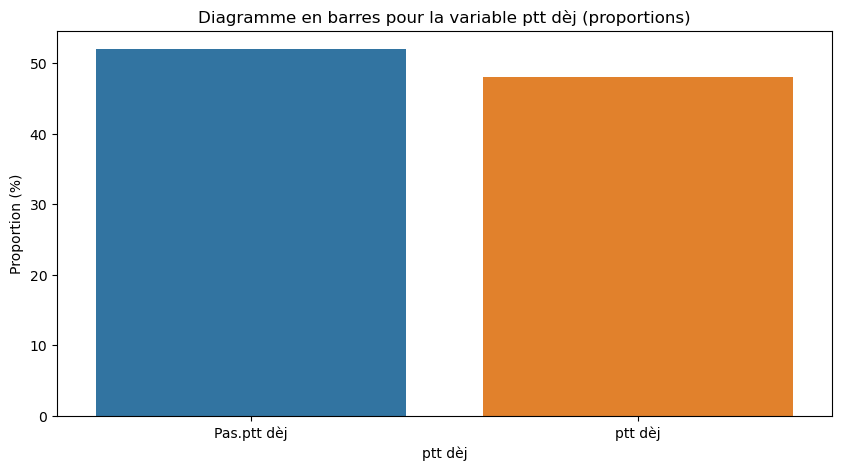

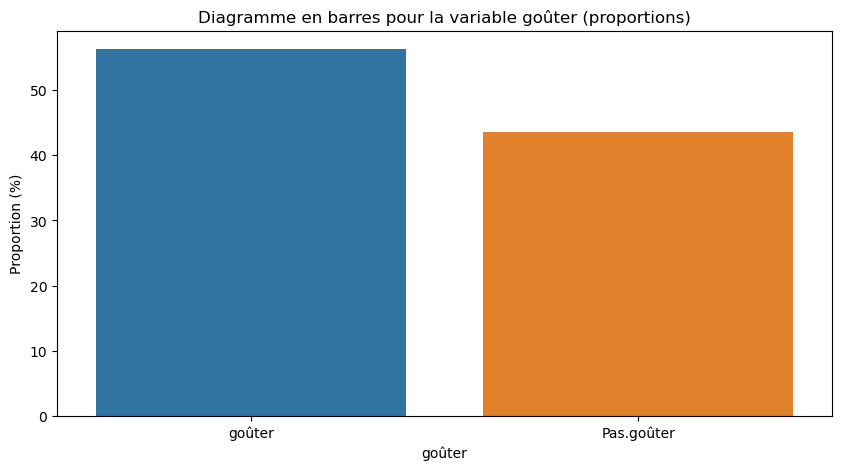

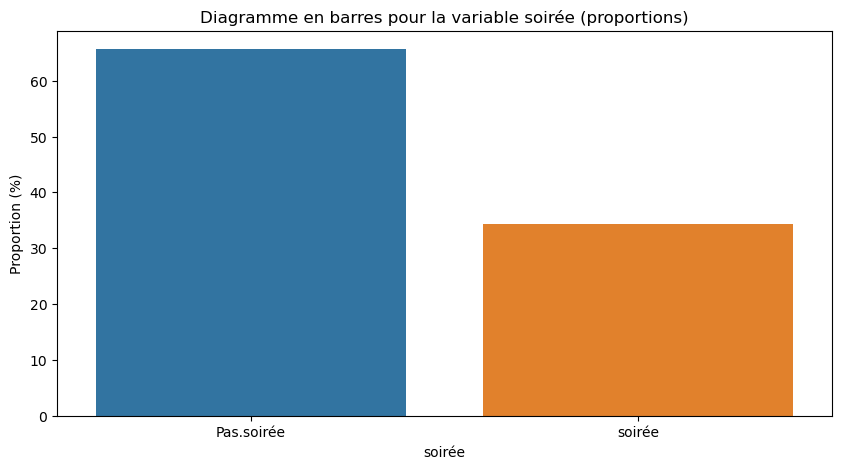

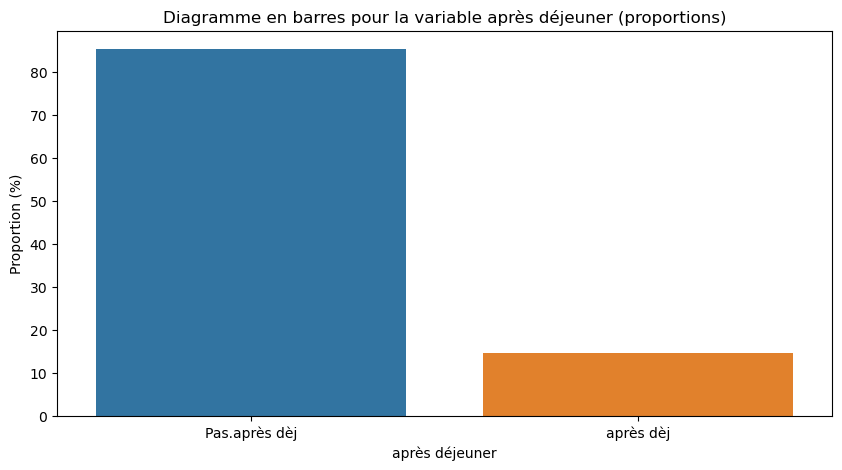

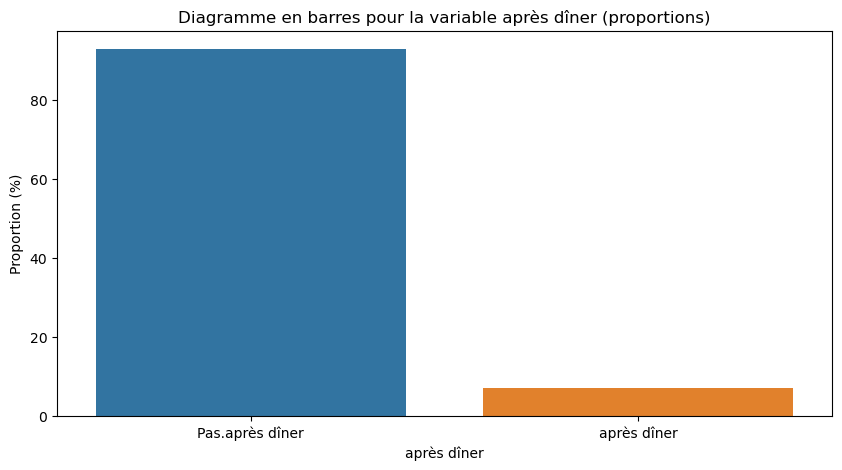

...

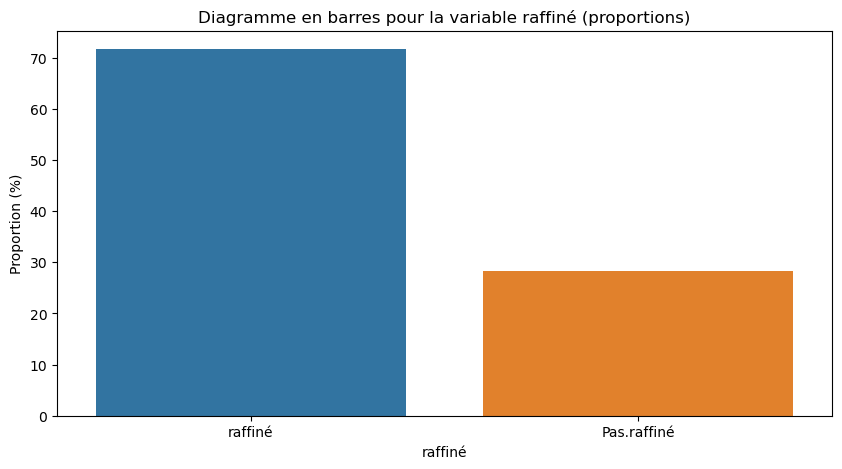

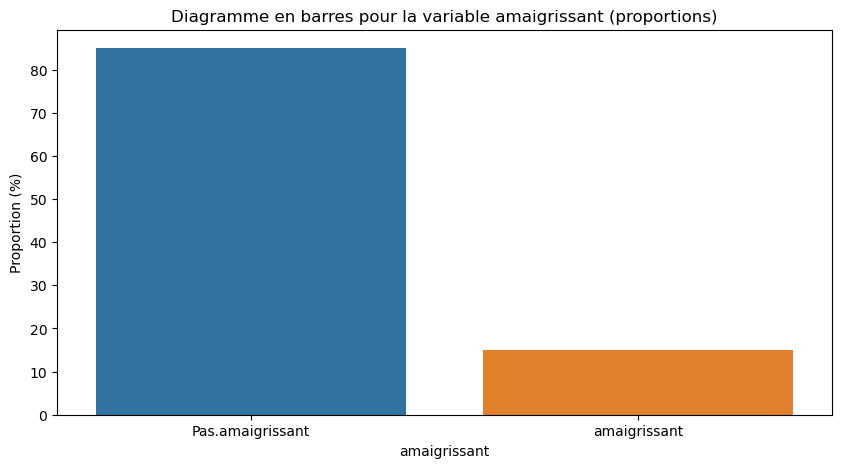

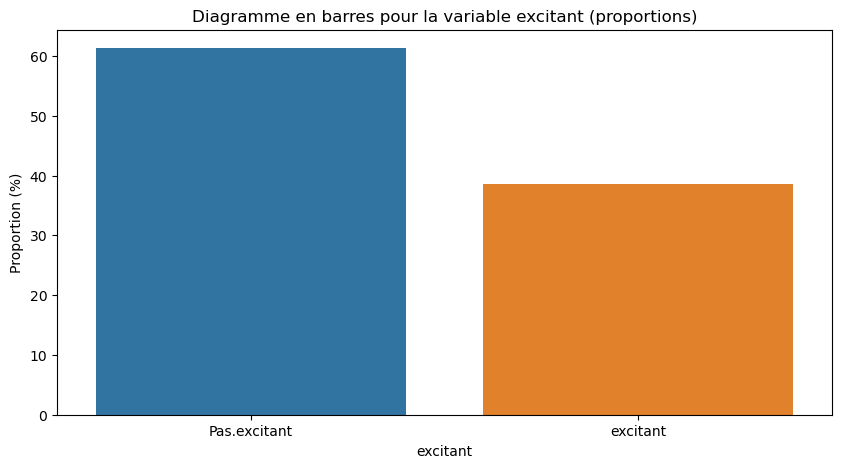

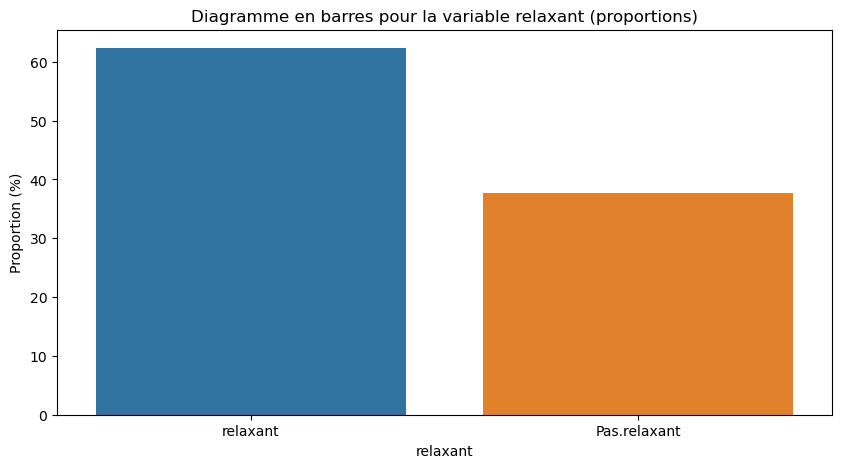

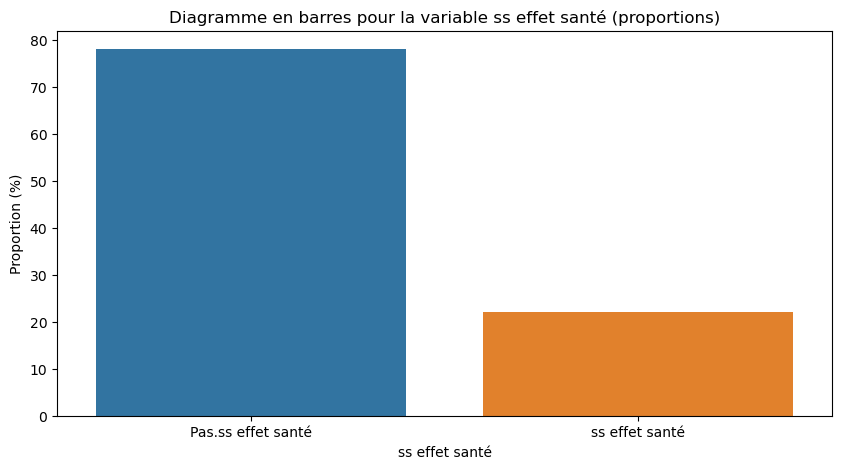

In [9]:
# Afficher les fréquences des variables catégorielles

# Créer des graphiques pour les variables catégorielles en termes de proportion
for col in categorical_columns:
    plt.figure(figsize=(10, 5))
    proportions = df[col].value_counts(normalize=True) * 100
    sns.barplot(x=proportions.index, y=proportions.values)
    plt.title(f"Diagramme en barres pour la variable {col} (proportions)")
    plt.ylabel('Proportion (%)')
    plt.show()

## Analyse bivariée

### Graphiques

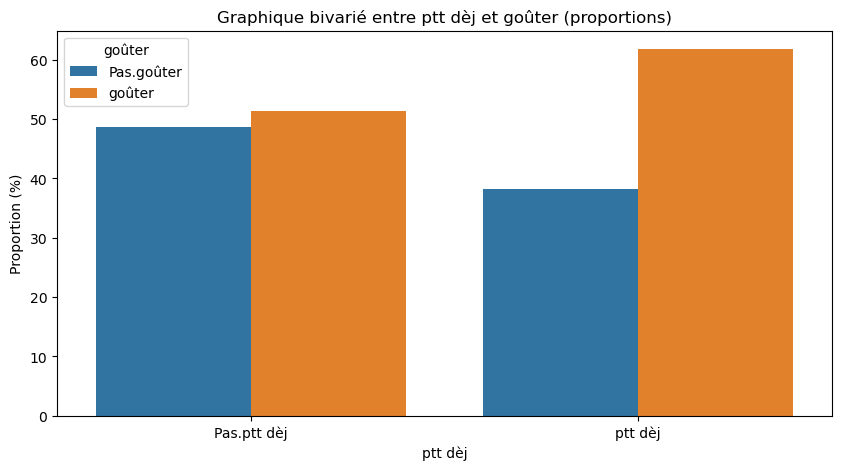

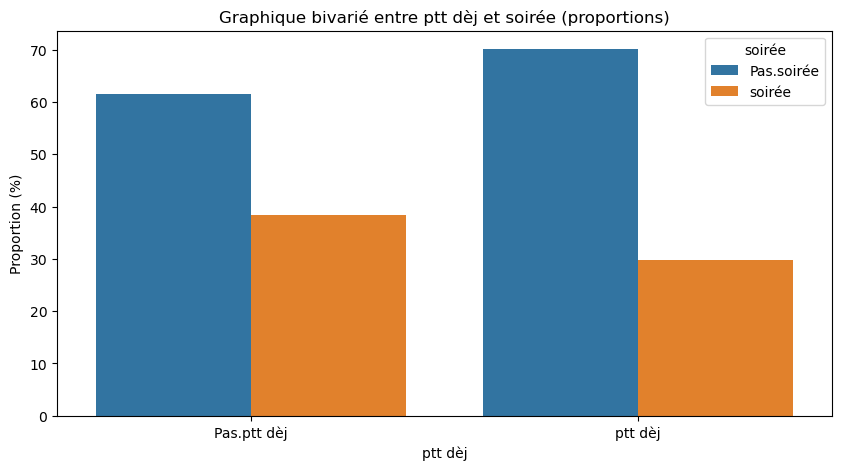

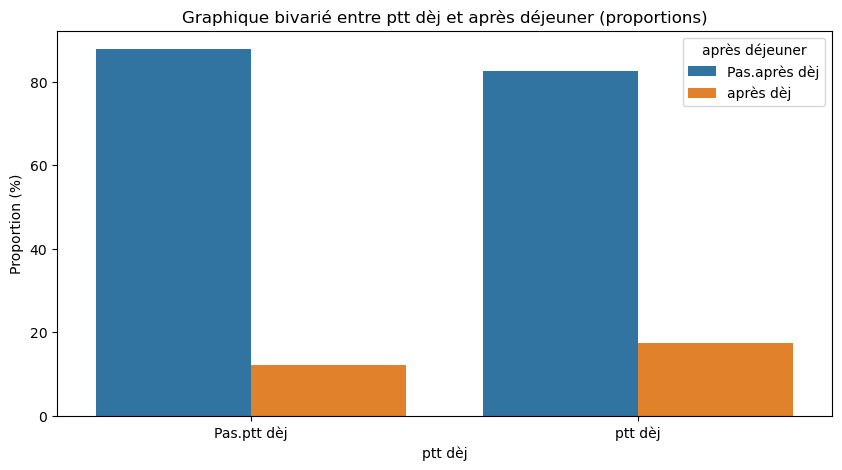

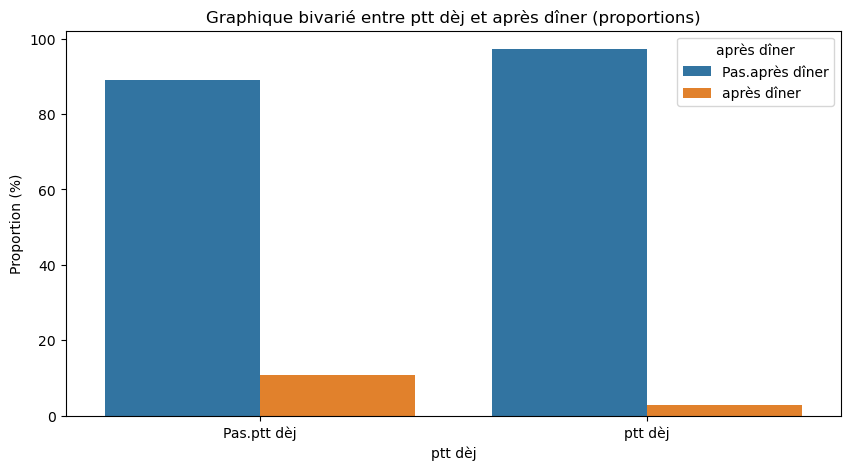

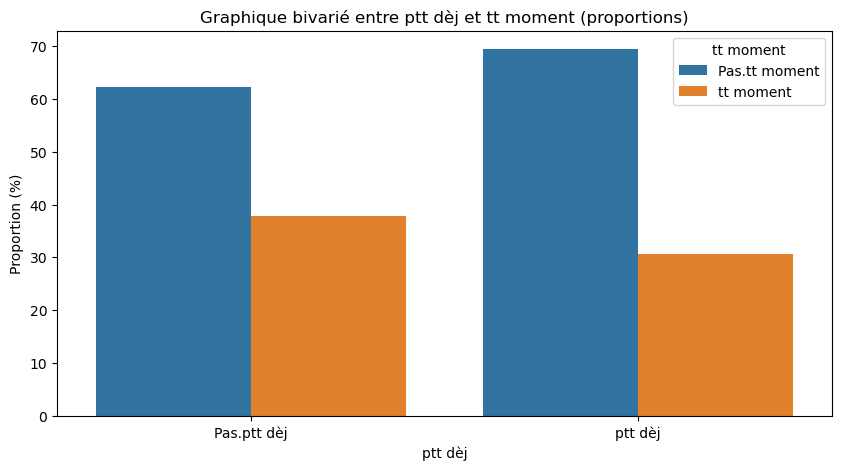

...

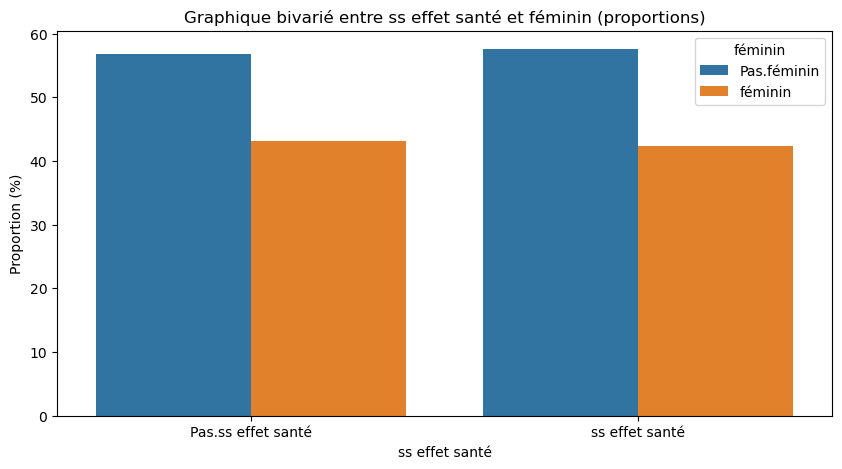

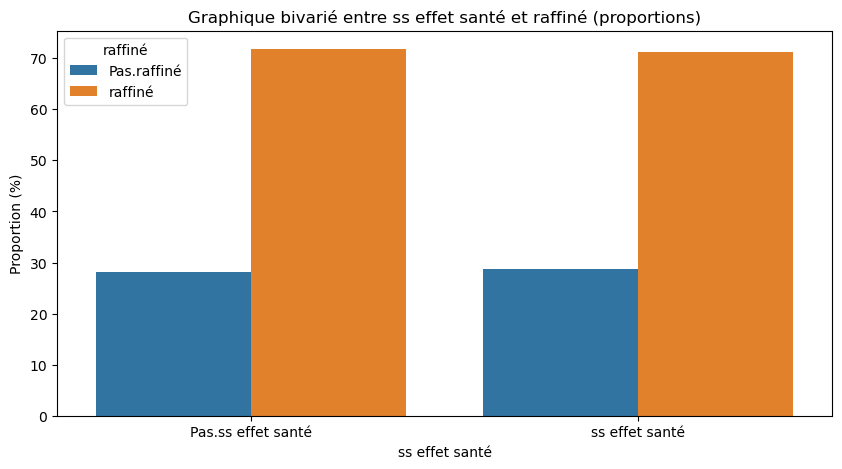

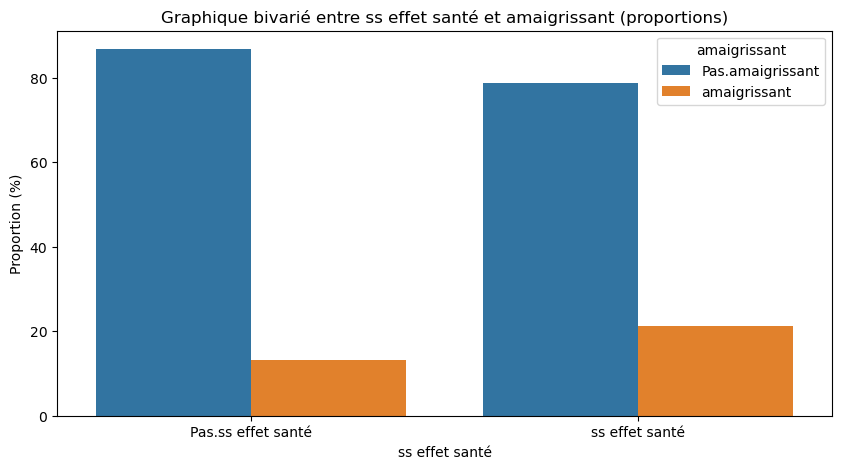

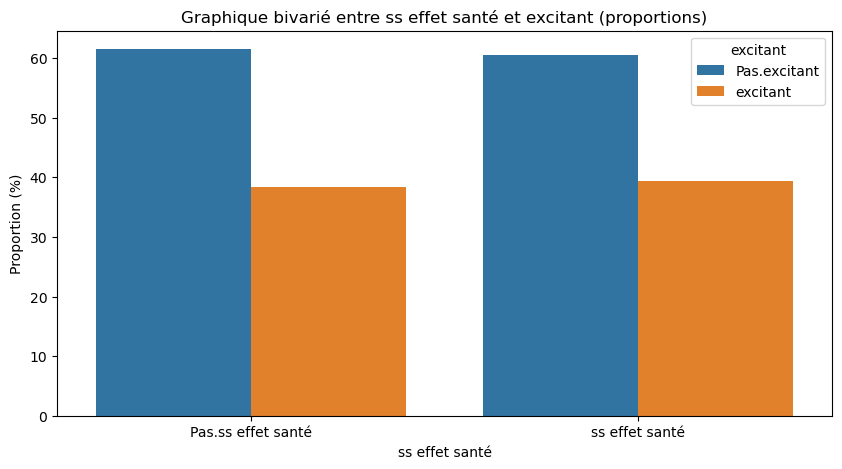

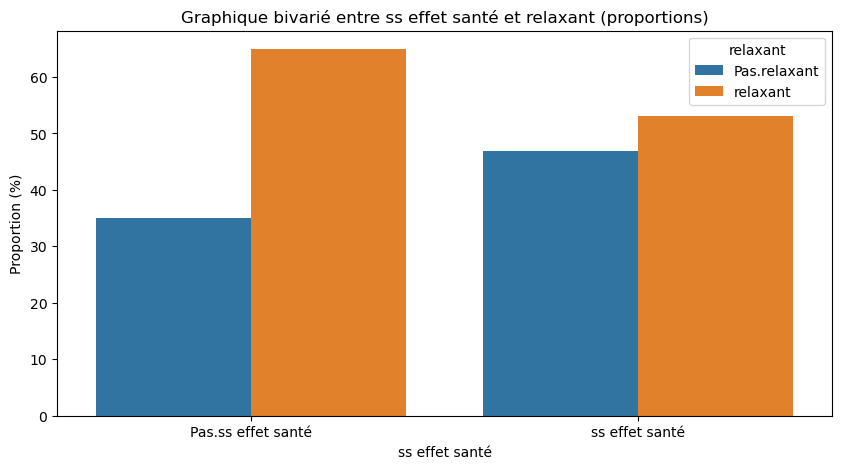

In [10]:
for col1 in categorical_columns[:5]:
    for col2 in categorical_columns[:5]:
        if col1 != col2:
            # Calculer les proportions pour le graphique bivarié
            proportions = df.groupby([col1, col2]).size().reset_index(name='Count')
            proportions['Proportion'] = proportions['Count'] / proportions.groupby(col1)['Count'].transform('sum') * 100

            # Créer un graphique en barres empilées pour la paire de variables
            plt.figure(figsize=(10, 5))
            sns.barplot(x=col1, y='Proportion', hue=col2, data=proportions)
            plt.title(f"Graphique bivarié entre {col1} et {col2} (proportions)")
            plt.ylabel('Proportion (%)')
            plt.show()


## Analyse multivariées grâce à l'ACM

### Instaciation de l'ACM avec FAnalysis

In [11]:
import fanalysis.mca as mca
# Liste des variables qualitatives
categorical_columns = ['ptt dèj', 'goûter', 'travail', 'variété',  'sexe','maison']

X = df[categorical_columns].values
df_result = df
new_mca = mca.MCA(row_labels=df_result.index.values, var_labels=categorical_columns)



In [12]:
# Estimation de l'ACM
new_mca.fit(X)

MCA(row_labels=array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 10...
       221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233,
       234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246,
       247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259,
       260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272,
       273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285,
       286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298,
       299]),
    var_labels=['ptt dèj', 'goûter', 'travail', 'variété', 'sexe', 'maison'])

### Choix du nombre d'axe factoriel

In [13]:
# Identification des valeurs propres
new_mca.eig_

array([[  0.25274216,   0.20596632,   0.18190821,   0.15746497,
          0.13567871,   0.12603502,   0.10687128],
       [ 21.66361381,  17.65425617,  15.59213212,  13.4969971 ,
         11.62960362,  10.80300213,   9.16039506],
       [ 21.66361381,  39.31786998,  54.9100021 ,  68.4069992 ,
         80.03660282,  90.83960494, 100.        ]])

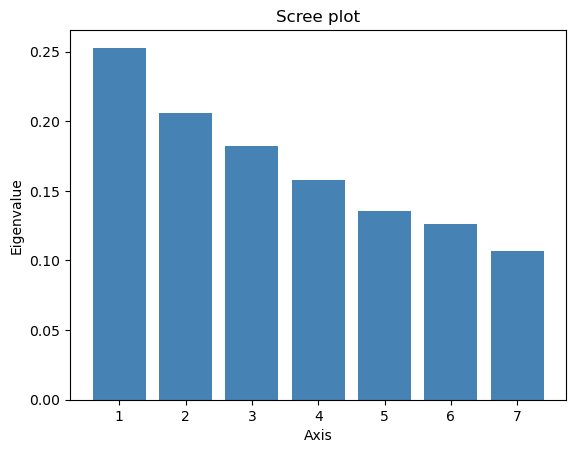

In [14]:
# Graphique des valeurs propres
new_mca.plot_eigenvalues()

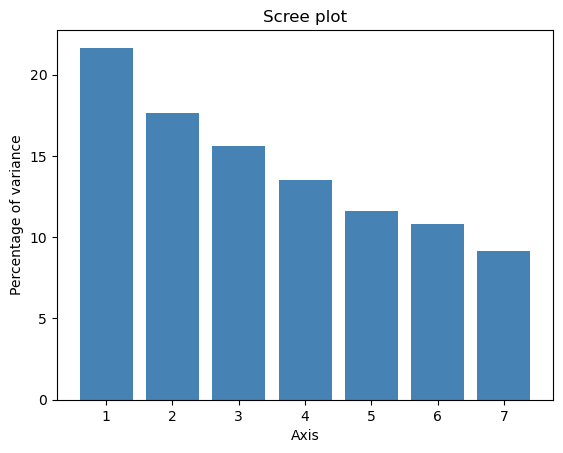

In [15]:
# Graphique des valeurs propres en pourcentage
new_mca.plot_eigenvalues(type="percentage")

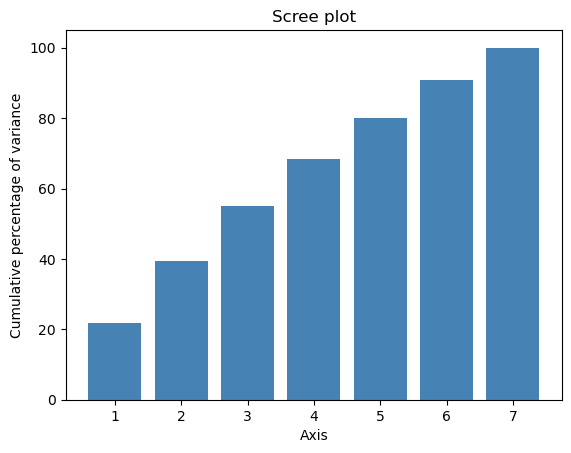

In [16]:
# Variance expliquée cumulée
new_mca.plot_eigenvalues(type="cumulative")

### Analyse de la qualité de représentation en ligne

#### Qualité profil ligne (individus)

Premier Axe


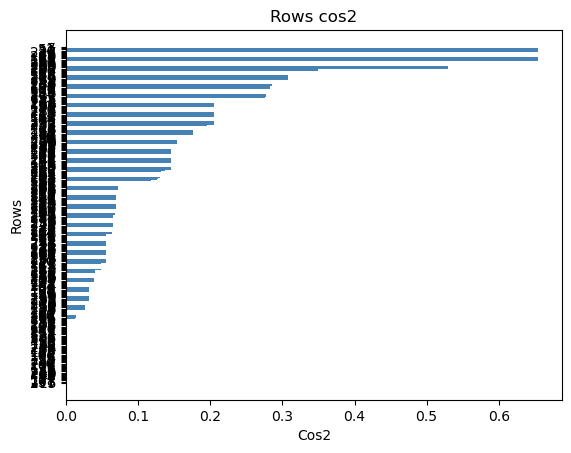

Deuxième  Axe


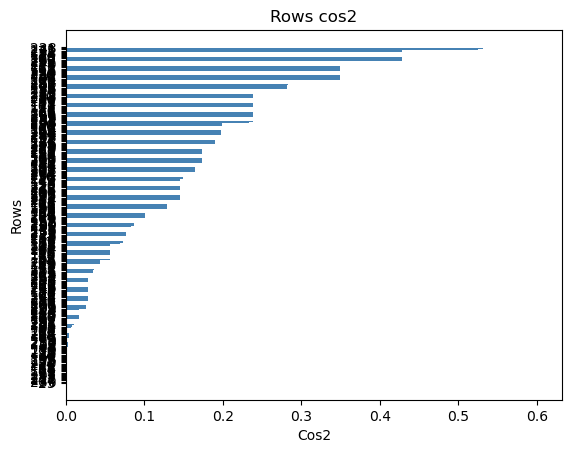

In [25]:
print("Premier Axe")
new_mca.plot_row_cos2(num_axis=4)

print("Deuxième  Axe")
new_mca.plot_row_cos2(num_axis=5)
                      


#### Qualité profil colonnes (modalités des variables)

Premier Axe


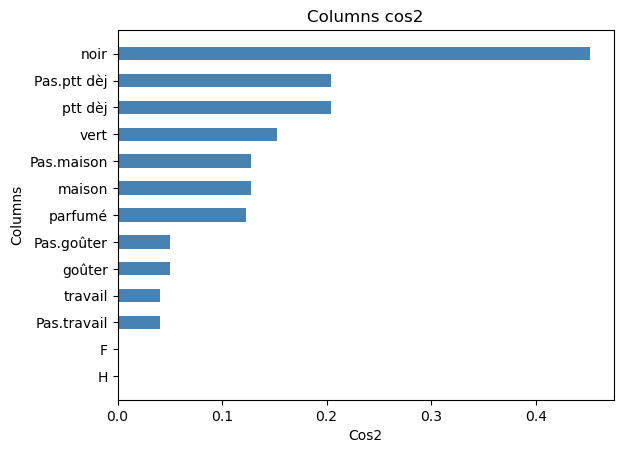

Deuxième  Axe


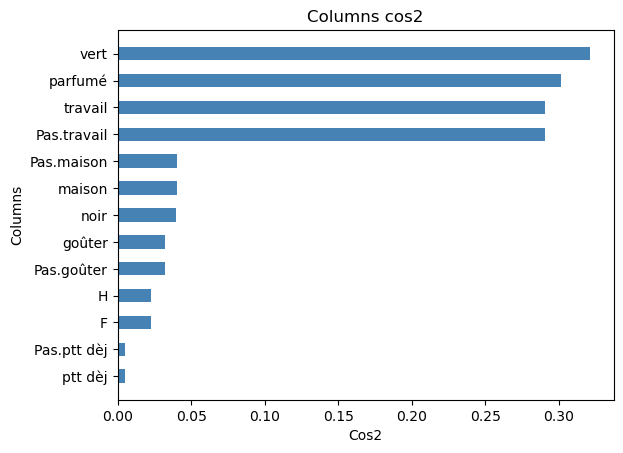

Deuxième  Axe


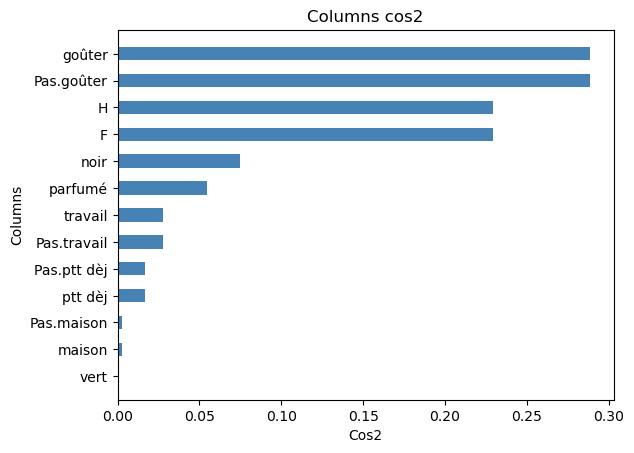

In [30]:
print("Premier Axe")
new_mca.plot_col_cos2(num_axis=1)

print("Deuxième  Axe")
new_mca.plot_col_cos2(num_axis=2)

print("Deuxième  Axe")
new_mca.plot_col_cos2(num_axis=3)

### Analyse des contributions

#### Contributions ligne

Premier Axe


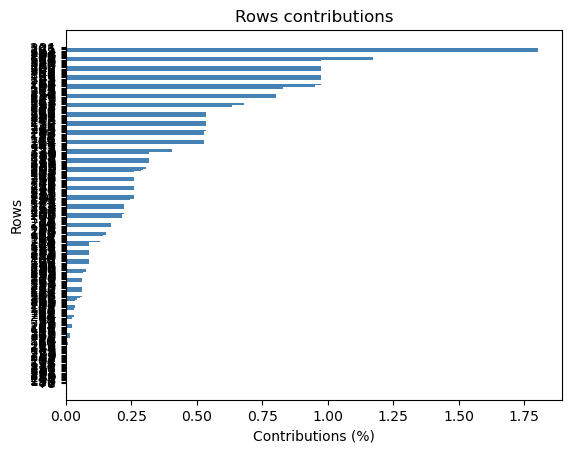

Deuxième  Axe


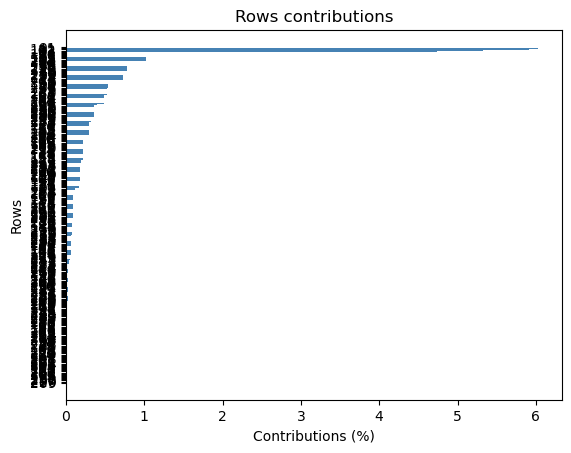

In [31]:
print("Premier Axe")
new_mca.plot_row_contrib(num_axis=1)

print("Deuxième  Axe")
new_mca.plot_row_contrib(num_axis=2)

#### Contribution profil colonne

Premier Axe


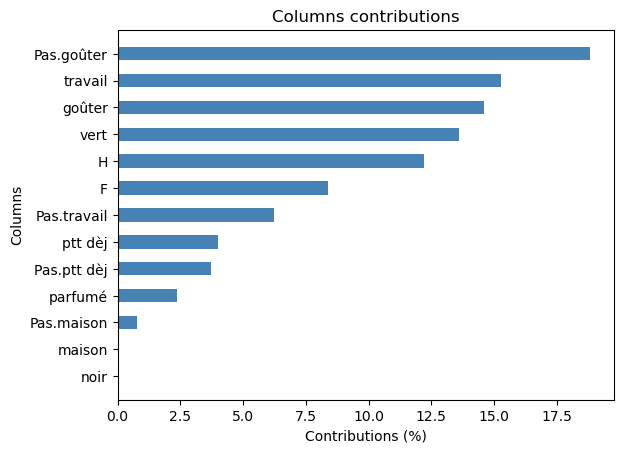

Deuxième  Axe


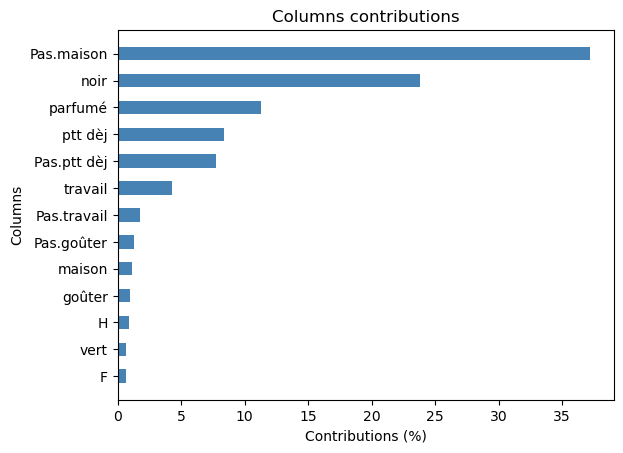

Troisième Axe


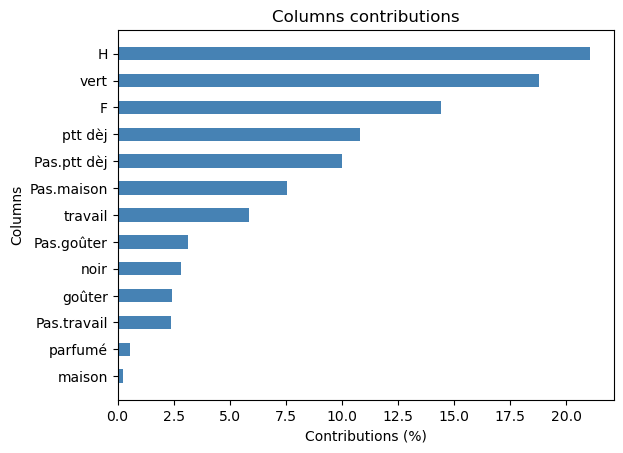

In [35]:
print("Premier Axe")
new_mca.plot_col_contrib(num_axis=1)

print("Deuxième  Axe")
new_mca.plot_col_contrib(num_axis=2)

print("Troisième Axe")
new_mca.plot_col_contrib(num_axis=3)

### Interprétation graphiques

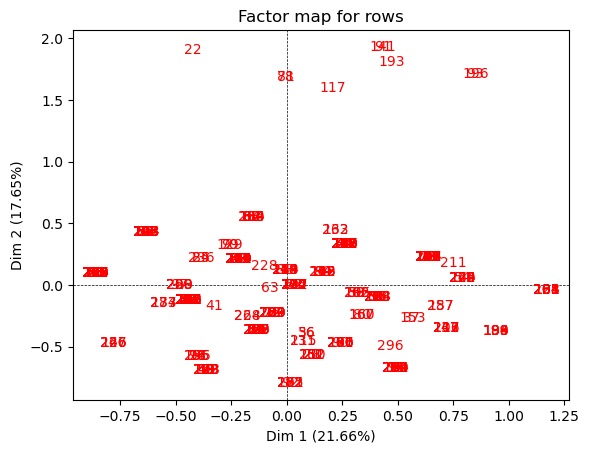

In [37]:
# Graphique profil ligne
new_mca.mapping_row(num_x_axis=1, num_y_axis=2)

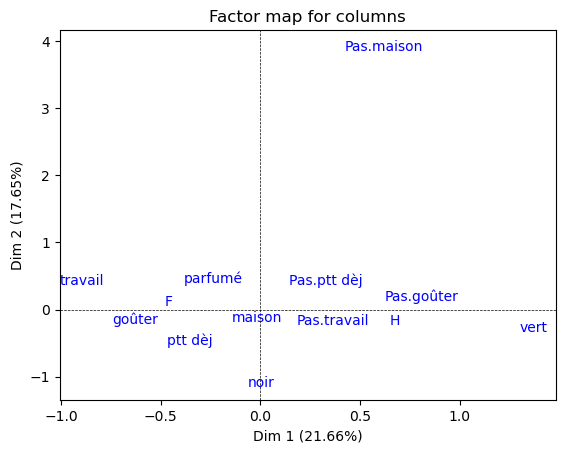

In [38]:
# Graphique des points colonnes (dim1 et dim2)
new_mca.mapping_col(num_x_axis=1, num_y_axis=2)

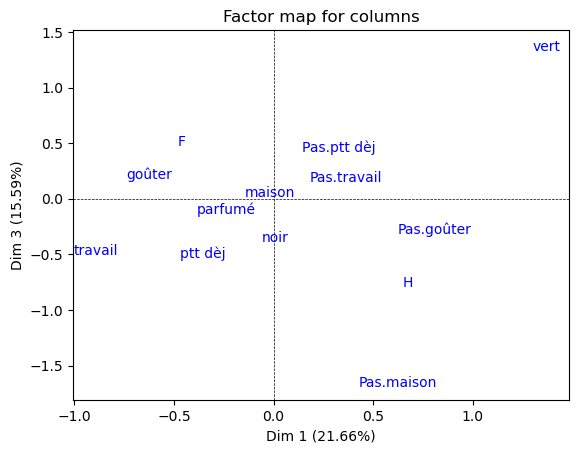

In [40]:
# Graphique des points colonnes (dim1 et dim3)
new_mca.mapping_col(num_x_axis=1, num_y_axis=3)

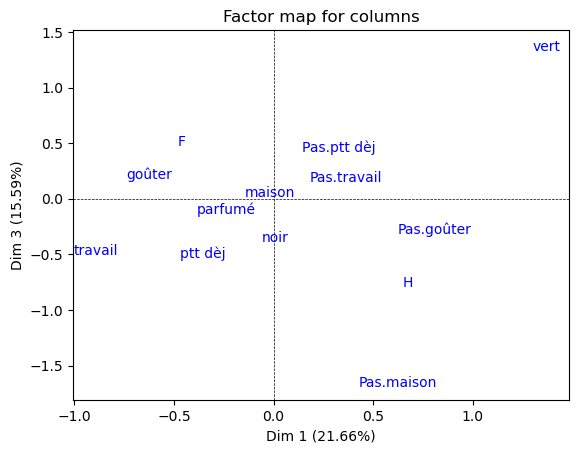

In [41]:
# Graphique des points colonnes (dim2 et dim3)
new_mca.mapping_col(num_x_axis=1, num_y_axis=3)

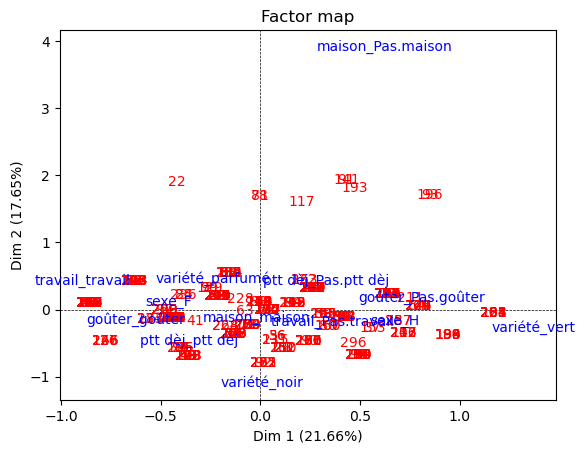

In [42]:
# Graphique superposition si nécessaire
new_mca.mapping(num_x_axis=1, num_y_axis=2, short_labels=False)